## Case James Delivery - Abril/2022 - Analista Luiz Eduardo Oliveira

## EDA - Análise Exploratória de Dados
### 1) Carga dos Datasets
### 2) Verificação de campos nulos
### 3) Verificação de correlação entre os campos do dataset (Heatmap)
### 4) Sumarização de campos núméricos ('checkout_price','base_price','num_orders')
####    -Detecção de Outliers
####    -Remoção de Outliers
####    -Preço média dos pedidos geral
####    -Preço Médio dos pedidos por categoria 
### 5) Refeições Mais Vendidas?
####    -Vendas por categoria
####    -Vendas por tipo de cozinha
####    -Demanda por Cidade/Região/Área Operacional (op_area)
####    -Top 10 Refeições Mais vendidas
### 6) Refeições que trazem maior faturamento?
####    -Top 5 Maiores refeições em Faturamento
### 7) Quais os melhores depósitos?
####    -Melhor tipo de depósito com base no total de pedidos
####    -Melhor tipo de depósito com base no faturamento
####    -Top 3 Melhores depósitos com base no total de pedidos
####    -Top 3 Melhores depósitos com base no faturamento
### 8) O que traz mais retorno: anunciar a comida na homepage ou enviar email?
### 9) Qual a tendência de vendas?
####   -Demanda Semanal (Série de 145 Semanas)
####   -Previsão de demanda

In [ ]:
#!pip install plotly

In [1]:
import pandas as pd
import seaborn as srn
import statistics  as sts
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np

### 1) Carga dos Datasets

In [2]:
#importar dados de trainamento
training_data = pd.read_csv("archive\\train.csv", sep=",")
training_data.head(n=10)

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders
0,1379560,1,55,1885,136.83,152.29,0,0,177
1,1466964,1,55,1993,136.83,135.83,0,0,270
2,1346989,1,55,2539,134.86,135.86,0,0,189
3,1338232,1,55,2139,339.50,437.53,0,0,54
4,1448490,1,55,2631,243.50,242.50,0,0,40
5,1270037,1,55,1248,251.23,252.23,0,0,28
6,1191377,1,55,1778,183.36,184.36,0,0,190
7,1499955,1,55,1062,182.36,183.36,0,0,391
8,1025244,1,55,2707,193.06,192.06,0,0,472
9,1054194,1,55,1207,325.92,384.18,0,1,676


In [3]:
#tamanho
training_data.shape

(456548, 9)

In [4]:
#importar dados de teste
testing_data = pd.read_csv("archive\\test.csv", sep=",")
testing_data.head(n=10)

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured
0,1028232,146,55,1885,158.11,159.11,0,0
1,1127204,146,55,1993,160.11,159.11,0,0
2,1212707,146,55,2539,157.14,159.14,0,0
3,1082698,146,55,2631,162.02,162.02,0,0
4,1400926,146,55,1248,163.93,163.93,0,0
5,1284113,146,55,1778,190.15,190.15,0,0
6,1197966,146,55,1062,191.09,192.09,0,0
7,1132739,146,55,2707,242.56,240.56,0,0
8,1057981,146,55,1207,360.90,360.90,0,0
9,1095932,146,55,1230,383.18,384.18,0,0


In [5]:
# tamanho
testing_data.shape

(32573, 8)

In [6]:
#importar dados sobre refeições
meal_info_data = pd.read_csv("archive\\meal_info.csv", sep=",")
meal_info_data.head(n=10)

,meal_id,category,cuisine
0,1885,Beverages,Thai
1,1993,Beverages,Thai
2,2539,Beverages,Thai
3,1248,Beverages,Indian
4,2631,Beverages,Indian
5,1311,Extras,Thai
6,1062,Beverages,Italian
7,1778,Beverages,Italian
8,1803,Extras,Thai
9,1198,Extras,Thai


In [7]:
# tamanho
meal_info_data.shape

(51, 3)

In [8]:
#importar dados sobre os centros de distribuição (depósitos)
center_info_data = pd.read_csv("archive\\fulfilment_center_info.csv", sep=",")
center_info_data.head(n=10)

,center_id,city_code,region_code,center_type,op_area
0,11,679,56,TYPE_A,3.7
1,13,590,56,TYPE_B,6.7
2,124,590,56,TYPE_C,4.0
3,66,648,34,TYPE_A,4.1
4,94,632,34,TYPE_C,3.6
5,64,553,77,TYPE_A,4.4
6,129,593,77,TYPE_A,3.9
7,139,693,34,TYPE_C,2.8
8,88,526,34,TYPE_A,4.1
9,143,562,77,TYPE_B,3.8


In [9]:
#tamanho
center_info_data.shape

(77, 5)

In [10]:
#Combinação das informações de refeição com dados de treinamento
train_data_merge = pd.merge(training_data, meal_info_data, how = 'inner', on = 'meal_id')

In [11]:
#Combinação das informações de refeição, centro de distribuição com dados de treinamento
train_data_temp = pd.merge(train_data_merge, center_info_data, how = 'inner', on = 'center_id')
train_data = train_data_temp

In [12]:
train_data.head(10)

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders,category,cuisine,city_code,region_code,center_type,op_area
0,1379560,1,55,1885,136.83,152.29,0,0,177,Beverages,Thai,647,56,TYPE_C,2.0
1,1018704,2,55,1885,135.83,152.29,0,0,323,Beverages,Thai,647,56,TYPE_C,2.0
2,1196273,3,55,1885,132.92,133.92,0,0,96,Beverages,Thai,647,56,TYPE_C,2.0
3,1116527,4,55,1885,135.86,134.86,0,0,163,Beverages,Thai,647,56,TYPE_C,2.0
4,1343872,5,55,1885,146.50,147.50,0,0,215,Beverages,Thai,647,56,TYPE_C,2.0
5,1493612,6,55,1885,146.53,146.53,0,0,285,Beverages,Thai,647,56,TYPE_C,2.0
6,1110832,7,55,1885,145.53,146.53,0,0,148,Beverages,Thai,647,56,TYPE_C,2.0
7,1461167,8,55,1885,146.53,145.53,0,0,135,Beverages,Thai,647,56,TYPE_C,2.0
8,1102364,9,55,1885,134.83,134.83,0,0,175,Beverages,Thai,647,56,TYPE_C,2.0
9,1018130,10,55,1885,144.56,143.56,0,0,175,Beverages,Thai,647,56,TYPE_C,2.0


In [13]:
# tamanho
train_data.shape

(456548, 15)

In [14]:
#ordenação por semana
train_data.sort_values(by=['week']).head()

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders,category,cuisine,city_code,region_code,center_type,op_area
0,1379560,1,55,1885,136.83,152.29,0,0,177,Beverages,Thai,647,56,TYPE_C,2.0
284804,1409622,1,113,2444,658.63,660.63,0,0,14,Seafood,Continental,680,77,TYPE_C,4.0
285005,1203879,1,113,1525,244.50,282.33,0,0,14,Other Snacks,Thai,680,77,TYPE_C,4.0
285106,1235654,1,113,2704,242.50,280.33,0,0,121,Other Snacks,Thai,680,77,TYPE_C,4.0
43263,1393327,1,52,1248,247.35,247.35,0,0,81,Beverages,Indian,685,56,TYPE_B,5.6


### 2) Verificação de campos nulos

In [15]:
#Verificação da presença de valores nulos
train_data.isnull().sum()

id                       0
week                     0
center_id                0
meal_id                  0
checkout_price           0
base_price               0
emailer_for_promotion    0
homepage_featured        0
num_orders               0
category                 0
cuisine                  0
city_code                0
region_code              0
center_type              0
op_area                  0
dtype: int64

### 3) Verificação de correlação entre os campos do dataset (Heatmap)

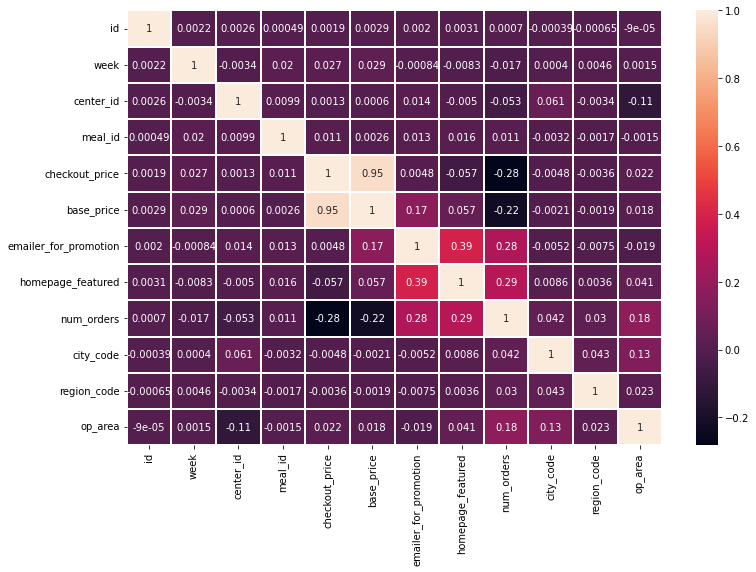

In [16]:
fig, ax = plt.subplots(figsize=(12, 8))
ax = srn.heatmap(train_data.corr(), annot=True, linewidths=.10)
plt.show()

### 4) Sumarização de campos núméricos ('checkout_price','base_price')

In [17]:
train_data[['checkout_price','base_price','num_orders']].describe()

,checkout_price,base_price,num_orders
count,456548.000000,456548.000000,456548.000000
mean,332.238933,354.156627,261.872760
std,152.939723,160.715914,395.922798
min,2.970000,55.350000,13.000000
25%,228.950000,243.500000,54.000000
50%,296.820000,310.460000,136.000000
75%,445.230000,458.870000,324.000000
max,866.270000,866.270000,24299.000000


##### Detecção de Outliers

In [18]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

cols = train_data[['week','checkout_price','base_price','num_orders']]

plot_rows=2
plot_cols=2
fig = make_subplots(rows=plot_rows, cols=plot_cols)

# add traces
x = 0
for i in range(1, plot_rows + 1):
    for j in range(1, plot_cols + 1):
        #print(str(i)+ ', ' + str(j))
        fig.add_trace(go.Box(name= cols.columns[x], y = cols[cols.columns[x]].values), row=i, col=j)

        x=x+1

fig.update_layout(height=700,width=700)
fig.show()

# fig = px.box(train_data, y="base_price")
# fig.update_layout(height=500,width=370)
# fig.show()

##### Remoção de Outliers

In [19]:
#Colocar os valores discrepantes dentro do domínio com o valor da mediana
desv_cp = sts.stdev(train_data['checkout_price'])
train_data.loc[train_data['checkout_price'] >=  2 * desv_cp ].head()

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders,category,cuisine,city_code,region_code,center_type,op_area
434,1338232,1,55,2139,339.50,437.53,0,0,54,Beverages,Indian,647,56,TYPE_C,2.0
435,1318577,3,55,2139,340.50,435.53,0,0,14,Beverages,Indian,647,56,TYPE_C,2.0
436,1190134,6,55,2139,435.53,435.53,0,0,15,Beverages,Indian,647,56,TYPE_C,2.0
437,1194808,8,55,2139,435.53,437.53,0,0,13,Beverages,Indian,647,56,TYPE_C,2.0
438,1468496,9,55,2139,388.03,437.53,0,0,15,Beverages,Indian,647,56,TYPE_C,2.0


In [20]:
desv_bp = sts.stdev(train_data['base_price'])
train_data.loc[train_data['base_price'] >=  2 * desv_bp ].head()

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders,category,cuisine,city_code,region_code,center_type,op_area
434,1338232,1,55,2139,339.50,437.53,0,0,54,Beverages,Indian,647,56,TYPE_C,2.0
435,1318577,3,55,2139,340.50,435.53,0,0,14,Beverages,Indian,647,56,TYPE_C,2.0
436,1190134,6,55,2139,435.53,435.53,0,0,15,Beverages,Indian,647,56,TYPE_C,2.0
437,1194808,8,55,2139,435.53,437.53,0,0,13,Beverages,Indian,647,56,TYPE_C,2.0
438,1468496,9,55,2139,388.03,437.53,0,0,15,Beverages,Indian,647,56,TYPE_C,2.0


In [21]:
desv_no = sts.stdev(train_data['num_orders'])
train_data.loc[train_data['num_orders'] >=  2 * desv_no ].head()

,id,week,center_id,meal_id,checkout_price,base_price,emailer_for_promotion,homepage_featured,num_orders,category,cuisine,city_code,region_code,center_type,op_area
197,1126342,53,55,1993,120.28,145.56,1,1,1161,Beverages,Thai,647,56,TYPE_C,2.0
341,1394038,53,55,2539,120.28,146.53,1,1,959,Beverages,Thai,647,56,TYPE_C,2.0
1273,1273224,52,55,1207,289.12,475.36,1,1,933,Beverages,Continental,647,56,TYPE_C,2.0
1274,1329742,53,55,1207,288.09,475.36,0,1,986,Beverages,Continental,647,56,TYPE_C,2.0
1365,1469367,1,55,1230,323.01,390.00,0,1,823,Beverages,Continental,647,56,TYPE_C,2.0


In [22]:
mediana_cp = sts.median(train_data['checkout_price'])
mediana_bp = sts.median(train_data['base_price'])
mediana_no = int(round(sts.median(train_data['num_orders']),0))
print(f'Mediana preço checkout:{mediana_cp:.2f}')
print(f'Mediana preço base:{mediana_bp:.2f}')
print(f'Mediana num. pedidos:{mediana_no}')

Mediana preço checkout:296.82
Mediana preço base:310.46
Mediana num. pedidos:136


In [23]:
# Ajuste dos valores discrepantes
train_data.loc[train_data['checkout_price'] >= 2 * desv_cp , 'checkout_price'] = mediana_cp
train_data.loc[train_data['base_price'] >= 2 * desv_bp , 'base_price'] = mediana_bp
train_data.loc[train_data['num_orders'] >= 2 * desv_no , 'num_orders'] = mediana_no

####   Preço média dos pedidos geral/Preço Médio dos pedidos por categoria

In [24]:
mean_base_price = sts.mean(train_data['base_price'])
mean_checkout_price = sts.mean(train_data['checkout_price'])

In [25]:
print(f'Média preço base:{mean_base_price:.2f}')
print(f'Média preço checkout:{mean_checkout_price:.2f}')

Média preço base:270.20
Média preço checkout:254.99


In [26]:
# Preço Médio por categoria de refeição com base no preço de checkout
data_m_b = train_data.groupby(["category"])["checkout_price"].mean().reset_index(name='Preco_Medio_Venda')
data_m_b['Preco_Medio_Venda'] = round(data_m_b['Preco_Medio_Venda'],2)
data_m_b_ = data_m_b.sort_values(by='Preco_Medio_Venda',ascending=False)
print(data_m_b_)

        category  Preco_Medio_Venda
4           Fish             296.82
7          Pizza             296.82
11       Seafood             296.81
1        Biryani             296.79
2         Desert             296.36
6          Pasta             288.63
10      Sandwich             278.86
9          Salad             277.55
13      Starters             276.13
8      Rice Bowl             275.64
5   Other Snacks             256.42
12          Soup             222.95
0      Beverages             198.51
3         Extras             172.76


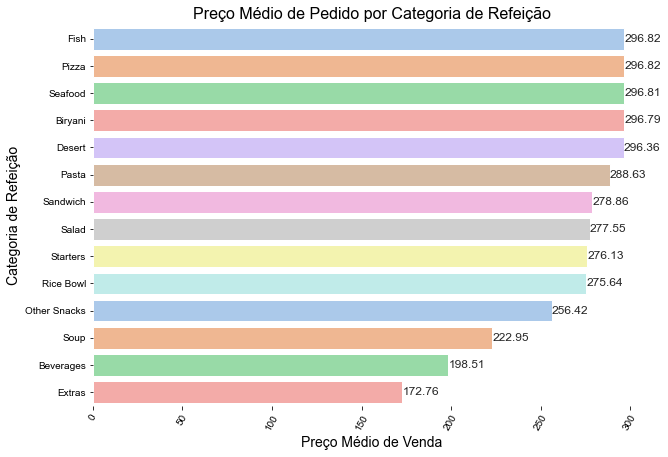

In [27]:
fig, ax = plt.subplots(figsize=(10, 7))
srn.set(style="whitegrid")
ax = srn.barplot(x="Preco_Medio_Venda",y="category", palette='pastel',  data=data_m_b_, ci=None)
ax.bar_label(ax.containers[0])
ax.axes.set_title('Preço Médio de Pedido por Categoria de Refeição', fontsize=16,color="black")
ax.set_xlabel("Preço Médio de Venda", size = 14, color="black")
plt.xticks(rotation=60)
ax.set_ylabel("Categoria de Refeição", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()

#### Distribuição dos Preços

C:\Users\lesan\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



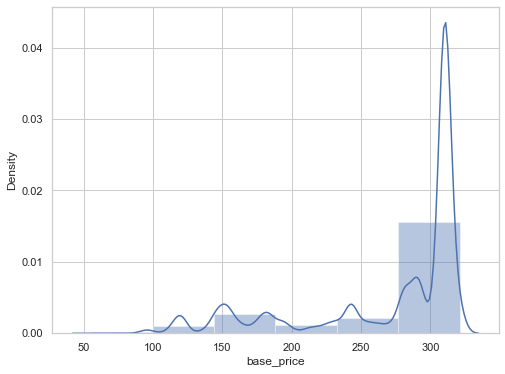

In [28]:
fig, ax = plt.subplots(figsize=(8, 6))
ax = srn.distplot(train_data['base_price'], bins=6)
ax =ax

C:\Users\lesan\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



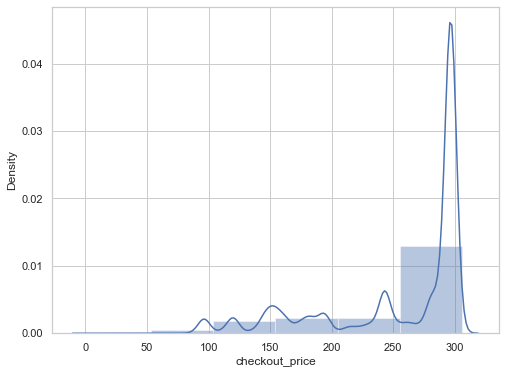

In [29]:
fig, ax = plt.subplots(figsize=(8, 6))
srn.distplot(train_data['checkout_price'], bins=6)
ax =ax

### 4) Refeições Mais Vendidas?

#### Vendas por categoria

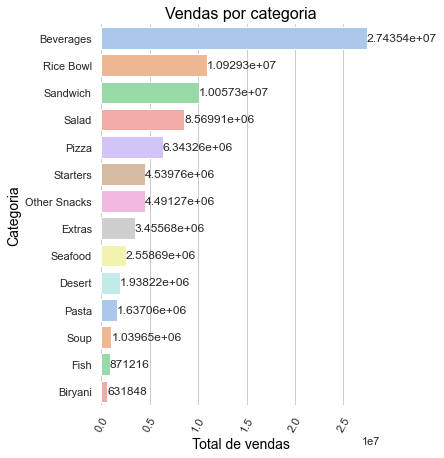

In [30]:
tdata = train_data.groupby(["category"])["num_orders"].sum().reset_index(name='Total')
fig, ax = plt.subplots(figsize=(5, 7))
srn.set(style="whitegrid")
ax = srn.barplot(x="Total",y="category", palette='pastel',  data=tdata.sort_values(by='Total',ascending=False), ci=None)
ax.bar_label(ax.containers[0])
ax.axes.set_title('Vendas por categoria', fontsize=16,color="black")
ax.set_xlabel("Total de vendas", size = 14, color="black")
plt.xticks(rotation=60)
ax.set_ylabel("Categoria", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()


#### Vendas por tipo de cozinha

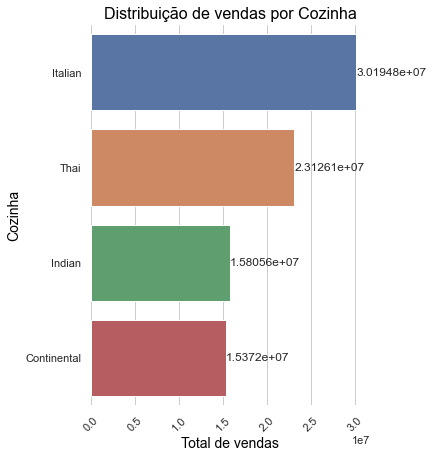

In [31]:
tdata = train_data.groupby(["cuisine"])["num_orders"].sum().reset_index(name='Total')
fig, ax = plt.subplots(figsize=(5, 7))
ax = srn.barplot(x="Total",y="cuisine", data=tdata.sort_values(by='Total',ascending=False))
ax.bar_label(ax.containers[0])
ax.axes.set_title("Distribuição de vendas por Cozinha", fontsize=16, color="black")
ax.set_xlabel("Total de vendas", size = 14, color="black")
plt.xticks(rotation=45)
ax.set_ylabel("Cozinha", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()

In [32]:
#explorar dados categóricos
#Refeições mais vendidas e suas categorias

df_meal = train_data.groupby(['meal_id'])["num_orders"].sum().reset_index(name='total')
print(df_meal.sort_values(by='total',ascending=False).head(n=10))


    meal_id    total
30     2290  4077584
0      1062  3891148
16     1754  3680826
1      1109  3645010
26     1993  3644966
48     2826  3605871
22     1885  3350314
44     2664  3324886
15     1727  3206728
46     2707  3164210


#### Demanda por Cidade/Região/Área Operacional (op_area)

In [33]:
# Cidades com maior e Menor número de pedidos
group_city_orders = train_data.groupby(['city_code'])['num_orders'].sum().reset_index(name='Tot_Pedidos')

##### Cidades com Maior Demanda

In [34]:
print(group_city_orders.sort_values(by='Tot_Pedidos', ascending=False).head(5))

    city_code  Tot_Pedidos
17        590     10758746
8         526      7482069
29        638      4152167
6         517      2519147
22        604      2492308


In [35]:
group_city_orders_mr = group_city_orders.sort_values(by='Tot_Pedidos', ascending=False).head(5)
group_city_orders_mr['city_code'] = group_city_orders['city_code'].astype(str)
#p = (group_city_orders_mr.loc[:,'Tot_Pedidos'].value_counts()/sum(train_data.loc[:,"num_orders"])*100)
fig = px.bar(group_city_orders_mr, x = ['Tot_Pedidos'] , y = group_city_orders_mr.city_code, 
      title = 'Cidades com Maior Número de Pedidos')
fig.update_xaxes(title_text='Num. Pedidos')
fig.update_yaxes(title_text='Cód. Cidade')
fig.update_layout(legend_title='Nº Pedidos')
fig.show()

##### Cidades com Menor Demanda

In [36]:
print(group_city_orders.sort_values(by='Tot_Pedidos', ascending=False).tail(5))

    city_code  Tot_Pedidos
35        658       762236
9         541       674452
48        702       653649
43        693       633077
3         478       596547


In [37]:
group_city_orders_mn = group_city_orders.sort_values(by='Tot_Pedidos', ascending=False).tail(5)
group_city_orders_mn['city_code'] = group_city_orders_mn['city_code'].astype(str)
fig = px.bar(group_city_orders_mn, x = ['Tot_Pedidos'] , y = group_city_orders_mn.city_code, 
       title = 'Cidades com Menor Número de Pedidos')
fig.update_xaxes(title_text='Num. Pedidos')
fig.update_yaxes(title_text='Cód. Cidade')
fig.update_layout(legend_title='Nº Pedidos')
fig.show()

In [38]:
# Regiões com com maior e menor número de pedidos
group_region_orders = train_data.groupby(['region_code'])['num_orders'].sum().reset_index(name='Tot_Pedidos')

##### Regiões com Maior Demanda

In [39]:
print(group_region_orders.sort_values(by='Tot_Pedidos', ascending=False).head(n=3))

   region_code  Tot_Pedidos
3           56     37683705
1           34     20123947
5           77     16877228


In [40]:
group_region_orders_mr = group_region_orders.sort_values(by='Tot_Pedidos', ascending=False).head(3)
group_region_orders_mr['region_code'] = group_region_orders_mr['region_code'].astype(str)
fig = px.bar(group_region_orders_mr, x = ['Tot_Pedidos'] , y = group_region_orders_mr.region_code, 
       title = 'Regiões com Maior Número de Pedidos')
fig.update_xaxes(title_text='Num. Pedidos')
fig.update_yaxes(title_text='Cód. Região')
fig.update_layout(legend_title='Nº Pedidos')
fig.show()

##### Regiões com Menor Demanda

In [41]:
print(group_region_orders.sort_values(by='Tot_Pedidos', ascending=False).tail(n=3))

   region_code  Tot_Pedidos
0           23      1163570
7           93       942529
2           35       653649


In [42]:
group_region_orders_mn = group_region_orders.sort_values(by='Tot_Pedidos', ascending=False).tail(3)
group_region_orders_mn['region_code'] = group_region_orders_mn['region_code'].astype(str)
fig = px.bar(group_region_orders_mn, x = ['Tot_Pedidos'] , y = group_region_orders_mn.region_code, 
       title = 'Regiões com Menor Número de Pedidos')
fig.update_xaxes(title_text='Num. Pedidos')
fig.update_yaxes(title_text='Cód. Região')
fig.update_layout(legend_title='Nº Pedidos')
fig.show()

In [43]:
# Área operacional com maior número de pedidos
group_op_area_orders = train_data.groupby(['op_area'])['num_orders'].sum().reset_index(name='Tot_Pedidos')

##### Área operacional (op_area) com Maior Demanda

In [44]:
print(group_op_area_orders.sort_values(by='Tot_Pedidos', ascending=False).head(n=5))

    op_area  Tot_Pedidos
15      4.0      9335134
14      3.9      8614692
13      3.8      6625969
18      4.4      5326390
19      4.5      4926277


In [45]:
group_op_area_orders_mr = group_op_area_orders.sort_values(by='Tot_Pedidos', ascending=False).head(n=5)
group_op_area_orders_mr['op_area'] = group_op_area_orders_mr['op_area'].astype(str)
fig = px.bar(group_op_area_orders_mr, x =['Tot_Pedidos'] , y = group_op_area_orders_mr.op_area, 
       title = 'Área Operacional com Maior Número de Pedidos')
fig.update_xaxes(title_text='Área')
fig.update_yaxes(title_text='Num. Pedidos')
fig.update_layout(legend_title='Nº Pedidos')
fig.show()

##### Área operacional (op_area) com Menor Demanda

In [46]:
print(group_op_area_orders.sort_values(by='Tot_Pedidos', ascending=False).tail(n=5))

   op_area  Tot_Pedidos
8      3.2      1093522
6      2.9       724455
3      2.4       596547
1      1.9       433293
0      0.9       397925


In [47]:
group_op_area_orders_mn = group_op_area_orders.sort_values(by='Tot_Pedidos', ascending=False).tail(n=5)
group_op_area_orders_mn['op_area'] = group_op_area_orders_mn['op_area'].astype(str)
fig = px.bar(group_op_area_orders_mn, x =['Tot_Pedidos'] , y = group_op_area_orders_mn.op_area, 
       title = 'Área Operacional com Menor Número de Pedidos')
fig.update_xaxes(title_text='Área')
fig.update_yaxes(title_text='Num. Pedidos')
fig.update_layout(legend_title='Nº Pedidos')
fig.show()

#### Top 10 Refeições Mais vendidas

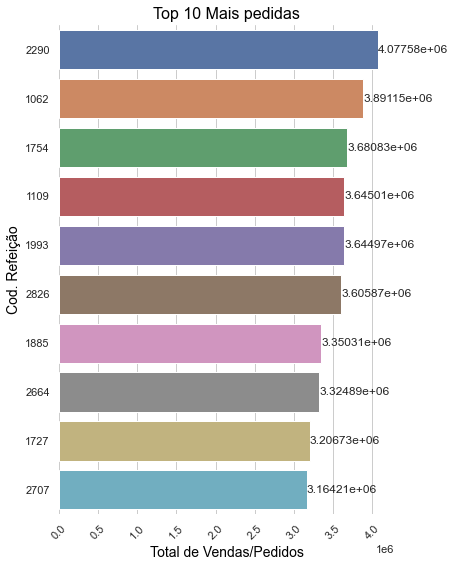

In [48]:
df_meal_sorted = df_meal.sort_values(by='total', ascending=False).head(n=10)

df_meal_sorted['meal_id'] = df_meal_sorted['meal_id'].astype(str)
type(df_meal_sorted['meal_id'])
fig, ax = plt.subplots(figsize=(6, 9))

ax = srn.barplot(x="total",y="meal_id", data=df_meal_sorted, orient = 'h',estimator = np.mean)
ax.bar_label(ax.containers[0])
ax.axes.set_title('Top 10 Mais pedidas', fontsize=16, color="black")
ax.set_xlabel("Total de Vendas/Pedidos", size = 14, color="black")
plt.xticks(rotation=45)
ax.set_ylabel("Cod. Refeição", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()

### 5) Refeições que trazem maior faturamento?

In [49]:
df_fat = train_data.groupby(['meal_id','checkout_price','category','cuisine'])['num_orders'].
          sum().reset_index(name='Tot_Pedidos')
df_fat['Faturamento'] = df_fat['Tot_Pedidos']*df_fat['checkout_price'] 

In [50]:
df_fat_n = df_fat.groupby(['meal_id'])['Faturamento'].sum().reset_index(name="Faturam_Total")
df_fat_n_ = df_fat_n.sort_values(by='Faturam_Total', ascending=False).head(n=10)
print(df_fat_n_)

    meal_id  Faturam_Total
30     2290   1.111508e+09
48     2826   1.032687e+09
16     1754   1.023358e+09
44     2664   9.723328e+08
1      1109   9.664102e+08
15     1727   9.432792e+08
39     2569   8.457007e+08
25     1971   7.663555e+08
24     1962   7.545963e+08
0      1062   6.656812e+08


#### Top 10 maiores refeições em Faturamento

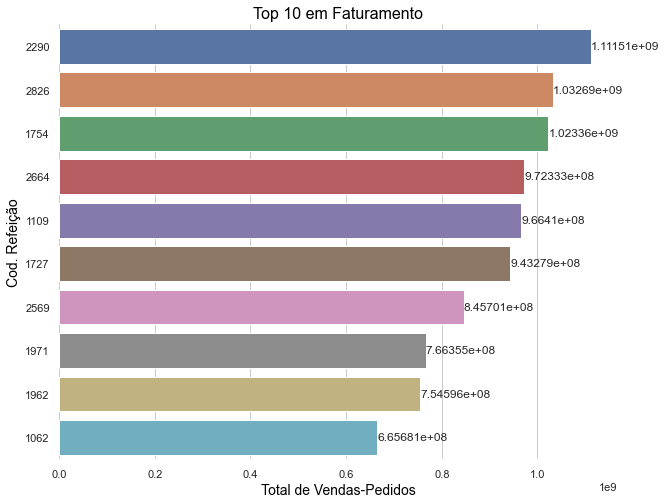

In [51]:
df_fat_n_['meal_id'] = df_fat_n_['meal_id'].astype(str)
fig, ax = plt.subplots(figsize=(10, 8))
ax = srn.barplot(x="Faturam_Total",y="meal_id", data=df_fat_n_)
ax.bar_label(ax.containers[0])
ax.axes.set_title('Top 10 em Faturamento', fontsize=16,color="black")
ax.set_xlabel("Total de Vendas-Pedidos", size = 14, color="black")
#plt.xticks(rotation=45)
ax.set_ylabel("Cod. Refeição", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()

### 6) Quais os melhores depósitos (centers)?

#### Melhor tipo de depósito com base no total de pedidos

In [52]:
# A estimativa do melhores depósitos é feita com base na quantidade de pedidos 
# e no faturamento que cada depósito representou nas 145 semandas
center_orders = train_data.groupby(['center_type'])['num_orders'].sum().reset_index(name='Tot_Pedidos')
print(center_orders)

  center_type  Tot_Pedidos
0      TYPE_A     48904446
1      TYPE_B     19353738
2      TYPE_C     16240357


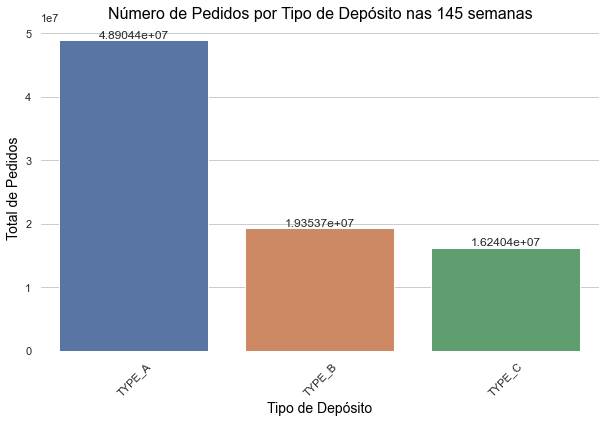

In [53]:
region_orders = pd.DataFrame(center_orders)
fig, ax = plt.subplots(figsize=(10, 6))
ax = srn.barplot(x="center_type",y="Tot_Pedidos", data=region_orders)
ax.bar_label(ax.containers[0])
ax.axes.set_title('Número de Pedidos por Tipo de Depósito nas 145 semanas', fontsize=16,color="black")
ax.set_xlabel("Tipo de Depósito", size = 14, color="black")
plt.xticks(rotation=45)
ax.set_ylabel("Total de Pedidos", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()
#px.bar(group_center_orders , x = group_center_orders.index, y = ['num_orders'], title = 'Number of Orders on Center Type')

#### Melhor tipo de depósito com base no faturamento

In [54]:
#Faturamento por tipo de depósito
center_orders = train_data.groupby(['center_type','checkout_price'])['num_orders'].sum().reset_index(name='Tot_Pedidos')
center_orders['Faturamento'] = center_orders['Tot_Pedidos']*center_orders['checkout_price']
center_orders_f = center_orders.groupby(['center_type'])['Faturamento'].sum().reset_index(name='Faturamento_Total')
print(center_orders_f)

  center_type  Faturamento_Total
0      TYPE_A       1.183973e+10
1      TYPE_B       4.778048e+09
2      TYPE_C       3.987946e+09


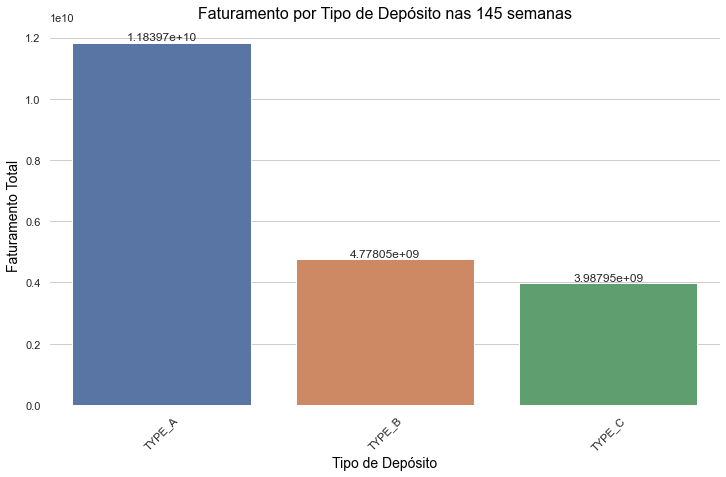

In [55]:
region_orders_f = pd.DataFrame(center_orders_f)
fig, ax = plt.subplots(figsize=(12, 7))
ax = srn.barplot(x="center_type",y='Faturamento_Total', data=region_orders_f)
ax.bar_label(ax.containers[0])
ax.axes.set_title('Faturamento por Tipo de Depósito nas 145 semanas', fontsize=16,color="black")
ax.set_xlabel("Tipo de Depósito", size = 14, color="black")
plt.xticks(rotation=45)
ax.set_ylabel("Faturamento Total", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()

#### Top 5 Melhores depósitos com base no total de pedidos

In [56]:
centerid_orders = train_data.groupby(["center_id"])["num_orders"].sum().reset_index(name='Tot_Pedidos')
centerid_orders_ = centerid_orders.sort_values(by='Tot_Pedidos', ascending=False).head(n=5)
centerid_orders_ = pd.DataFrame(centerid_orders_)
print(centerid_orders_)

    center_id  Tot_Pedidos
0          10      1724779
2          13      1708439
21         52      1619897
31         67      1611089
18         43      1543215


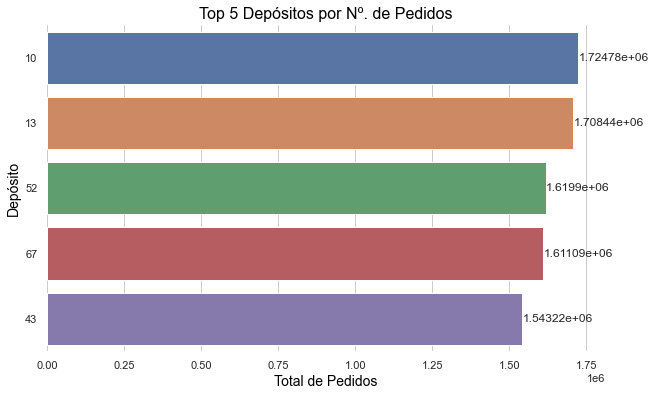

In [57]:
centerid_orders_['center_id'] = centerid_orders_['center_id'].astype(str)
fig, ax = plt.subplots(figsize=(10, 6))
ax = srn.barplot(x="Tot_Pedidos",y="center_id", data=centerid_orders_)
ax.bar_label(ax.containers[0])
ax.axes.set_title("Top 5 Depósitos por Nº. de Pedidos", fontsize=16, color="black")
ax.set_xlabel("Total de Pedidos", size = 14, color="black")
#plt.xticks(rotation=45)
ax.set_ylabel("Depósito", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()

#### Top 5 Melhores depósitos com base no faturamento

In [58]:
centerid_orders = train_data.groupby(["center_id","checkout_price"])["num_orders"].sum().reset_index(name='Tot_Pedidos')
centerid_orders_ = centerid_orders.sort_values(by='Tot_Pedidos', ascending=False).head(n=10)
centerid_orders_["Faturamento"] = centerid_orders_["checkout_price"]*centerid_orders_["Tot_Pedidos"]
centerid_orders_n = centerid_orders_.groupby(["center_id"])["Faturamento"].sum().reset_index(name='Faturam_Total')
print(centerid_orders_n.sort_values(by='Faturam_Total', ascending=False).head(5))

   center_id  Faturam_Total
0         10   2.103275e+08
2         13   2.046877e+08
3         43   1.867853e+08
5         67   1.834235e+08
6         75   1.826972e+08


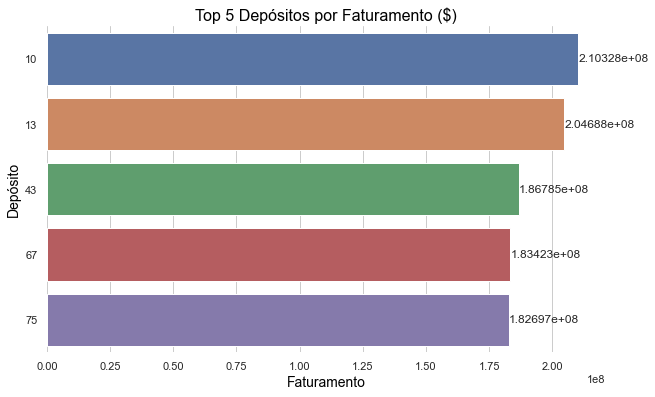

In [59]:
centerid_orders_n = centerid_orders_n.sort_values(by='Faturam_Total', ascending=False).head(5)
centerid_orders_n['center_id'] = centerid_orders_n['center_id'].astype(str)
fig, ax = plt.subplots(figsize=(10, 6))
ax = srn.barplot(x="Faturam_Total",y="center_id", data=centerid_orders_n)
ax.bar_label(ax.containers[0])
ax.axes.set_title("Top 5 Depósitos por Faturamento ($)", fontsize=16, color="black")
ax.set_xlabel("Faturamento", size = 14, color="black")
#plt.xticks(rotation=45)
ax.set_ylabel("Depósito", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()

### 8) O que traz mais retorno: anunciar a comida na homepage ou enviar email?

In [60]:
cols = ['emailer_for_promotion','homepage_featured']
for col in cols:
    fig = (px.bar(x = train_data[col].value_counts().index,
                 y = train_data[col].value_counts(),
                 title = str(col),
                 text = (train_data[col].value_counts()/len(train_data[col])*100))
          .update_traces(textposition='outside',texttemplate='%{text:.2s}%',
                         marker=dict(color='azure',line=dict(color='teal',width=2)))
          .update_layout(width=700))
    fig.show()

In [61]:
print(f"Número de Pedidos convertidos por promoção por e-mail: 
      {sum(train_data.loc[train_data['emailer_for_promotion']==1,'num_orders'])}")
print(f"Número de Pedidos convertidos por dados de homepage:
      {sum(train_data.loc[train_data['homepage_featured']==1,'num_orders'])}")


Número de Pedidos convertidos por promoção por e-mail: 9340852
Número de Pedidos convertidos por dados de homepage:12446163


In [71]:
orders_email = sum(train_data.loc[train_data['emailer_for_promotion']==1,'num_orders'])
orders_homepage = sum(train_data.loc[train_data['homepage_featured']==1,'num_orders'])
fat_email = sum(train_data.loc[train_data['emailer_for_promotion']==1,'num_orders']*
                train_data.loc[train_data['emailer_for_promotion']==1,'checkout_price'])
fat_homepage = sum(train_data.loc[train_data['homepage_featured']==1,'num_orders']*
                   train_data.loc[train_data['homepage_featured']==1,'checkout_price'])
df_retorno = pd.DataFrame(data={'categoria': ['emailer_for_promotion','homepage_featured'], 
                                'retorno_orders' : [orders_email, orders_homepage],
                                'retorno_fat':  [fat_email ,fat_homepage]})

In [72]:
print(df_retorno.loc[:,'retorno_orders'])

0     9340852
1    12446163
Name: retorno_orders, dtype: int64


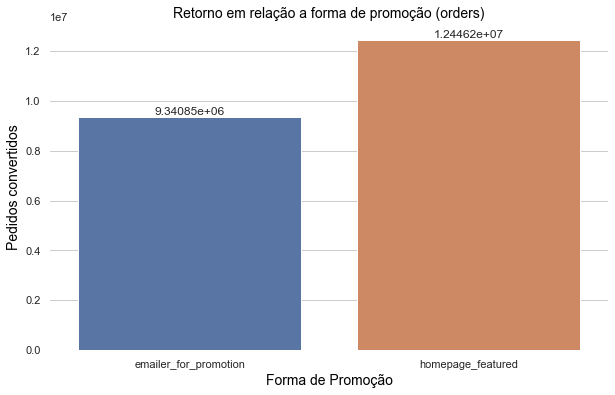

In [112]:
fig, ax = plt.subplots(figsize=(10, 6))
ax = srn.barplot(x="categoria",y="retorno_orders", data=df_retorno)
ax.bar_label(ax.containers[0])
ax.axes.set_title("Retorno em relação a forma de promoção (orders)", fontsize=14, color="black")
ax.set_xlabel("Forma de Promoção", size = 14, color="black")
#plt.xticks(rotation=45)
ax.set_ylabel("Pedidos convertidos", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()

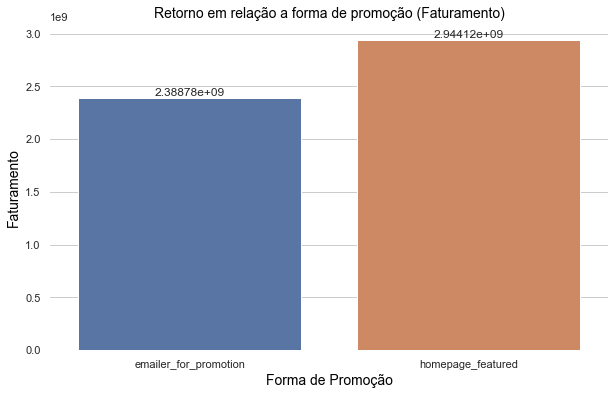

In [111]:
fig, ax = plt.subplots(figsize=(10, 6))
ax = srn.barplot(x="categoria",y="retorno_fat", data=df_retorno)
ax.bar_label(ax.containers[0])
ax.axes.set_title("Retorno em relação a forma de promoção (Faturamento)", fontsize=14, color="black")
ax.set_xlabel("Forma de Promoção", size = 14, color="black")
#plt.xticks(rotation=45)
ax.set_ylabel("Faturamento", size = 14,color="black")
srn.despine(left=True, bottom=True)
plt.show()

### 9) Qual a tendência de vendas?

<AxesSubplot:xlabel='week', ylabel='num_orders'>

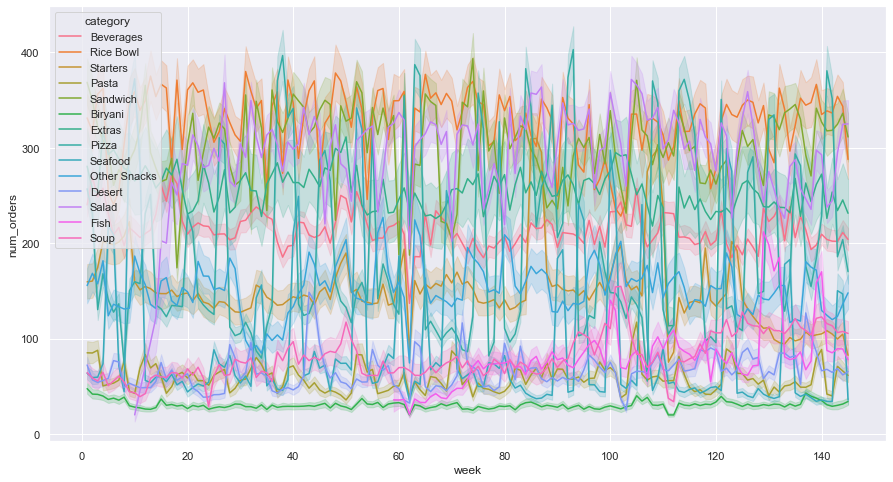

In [299]:
srn.set(rc={'figure.figsize':(15, 8)})
srn.lineplot(x="week", y="num_orders", data=train_data, hue="category")

In [78]:
#Em busca de uma tendência de vendas
week_orders = train_data.groupby(['week'])['num_orders'].sum().reset_index(name='Tot_Pedidos')
print(week_orders.head(10))

   week  Tot_Pedidos
0     1       581420
1     2       585870
2     3       547425
3     4       575568
4     5       523025
5     6       492802
6     7       471597
7     8       447602
8     9       556737
9    10       562895


In [80]:
week_orders_gp = pd.DataFrame(week_orders)
fig = px.scatter(week_orders_gp, x = week_orders_gp.week, 
                 y = ['Tot_Pedidos'], title='Tendência de demanda (Série de 145 semanas)',trendline="ols")
fig.update_xaxes(title_text='Semana')
fig.update_yaxes(title_text='Pedidos')
fig.update_layout(legend_title='Pedidos')
fig.show()

#### Previsão de Demanda

In [82]:
# Data Preprocessing library
from sklearn.model_selection import train_test_split
from math import sqrt

# Model Building
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
# Metric library
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

from sklearn.model_selection import RandomizedSearchCV,GridSearchCV,RepeatedStratifiedKFold

In [85]:
f_train = train_data.loc[:,['num_orders','week','center_id','meal_id','checkout_price','base_price','emailer_for_promotion',
                 'homepage_featured']]
final_train = pd.get_dummies(f_train)

In [86]:
features = final_train.iloc[:,1:].values
label = final_train.iloc[:,:1].values

In [91]:
#------------------LinearRegression --------------
X_train,X_test,y_train,y_test = train_test_split(features,label,test_size=0.20,random_state=1705)
model = LinearRegression()
model.fit(X_train,y_train)
y_pred = model.predict(X_test)

In [92]:
print("R2 score  :",r2_score(y_test, y_pred))
print("MSE score  :",mean_squared_error(y_test, y_pred))
print("RMSE: ",sqrt(mean_squared_error(y_test, y_pred)))

R2 score  : 0.06697870828622943
MSE score  : 27782.9758013424
RMSE:  166.68226000790366


In [93]:
#-------------- DecisionTreeRegressor-------------
X_train,X_test,y_train,y_test = train_test_split(features,label,test_size=0.20,random_state=1956)
DTRmodel = DecisionTreeRegressor(max_depth=3,random_state=0)
DTRmodel.fit(X_train,y_train)
y_pred = DTRmodel.predict(X_test)

In [94]:
print("R2 score  :",r2_score(y_test, y_pred))
print("MSE score  :",mean_squared_error(y_test, y_pred))
print("RMSE: ",sqrt(mean_squared_error(y_test, y_pred)))

R2 score  : 0.13892765170757326
MSE score  : 26170.569758277335
RMSE:  161.77320469805045


In [95]:
#---------- RandomForestRegressor --------------
X_train,X_test,y_train,y_test = train_test_split(features,label,test_size=0.20,random_state=33)
RFRmodel = RandomForestRegressor(max_depth=3, random_state=0)
RFRmodel.fit(X_train,y_train)
y_pred = RFRmodel.predict(X_test)

C:\Users\lesan\AppData\Local\Temp/ipykernel_28852/863406548.py:4: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



In [96]:
print("R2 score  :",r2_score(y_test, y_pred))
print("MSE score  :",mean_squared_error(y_test, y_pred))
print("RMSE: ",sqrt(mean_squared_error(y_test, y_pred)))

R2 score  : 0.141478198624703
MSE score  : 25968.743594771735
RMSE:  161.14820382111535


##### Conclusão: Optou-se pela algoritmo de Regressão de floresta aleatória (RandomForestRegressor) para o dataset, visto que o RMSE score:161.14820382111535 

In [113]:
final_test = testing_data.loc[:,['week','center_id','meal_id','checkout_price','base_price','emailer_for_promotion',
                 'homepage_featured']]

f_test = pd.get_dummies(final_test)

In [114]:
pred = RFRmodel.predict(f_test)

In [115]:
testing_data['num_orders'] = pred

In [116]:
amostra =  testing_data.loc[:,['id','week','num_orders']]

In [117]:
amostra.head()

,id,week,num_orders
0,1028232,146,212.833448
1,1127204,146,212.833448
2,1212707,146,212.833448
3,1082698,146,212.833448
4,1400926,146,189.488979


In [107]:
amostra.to_csv('sample_submission.csv',index=False)

In [108]:
week_orders = amostra.groupby(['week'])['num_orders'].sum().reset_index(name='Tot_Pedidos')
print(week_orders.head(10))

   week    Tot_Pedidos
0   146  744394.216758
1   147  753143.146961
2   148  772110.017598
3   149  771840.255989
4   150  756523.378840
5   151  742053.344528
6   152  753153.997394
7   153  753851.098683
8   154  742860.092852
9   155  730187.988648


In [110]:
week_orders_gp = pd.DataFrame(week_orders)
week_orders_gp['Tot_Pedidos'] = round(week_orders_gp['Tot_Pedidos'],0)
fig = px.scatter(week_orders_gp, x = week_orders_gp.week, y = ['Tot_Pedidos'], 
                 title='Demanda Prevista (a partir da semana 146)',trendline="ols")
fig.update_xaxes(title_text='Semana')
fig.update_yaxes(title_text='Pedidos')
fig.update_layout(legend_title='Pedidos')
fig.show()